# Formalia:

Please read the [assignment overview page](https://github.com/SocialComplexityLab/socialgraphs2022/wiki/Assignments) carefully before proceeding. This page contains information about formatting (including formats etc), group sizes, and many other aspects of handing in the assignment. 

_If you fail to follow these simple instructions, it will negatively impact your grade!_

**Due date and time**: The assignment is due on Tuesday November 1st, 2022 at 23:55. Hand in your IPython notebook file (with extension `.ipynb`) via http://peergrade.io/ (we won't be doing peergrading, but we'll still use http://peergrade.io/ for the handin.)

# Data

This assignment will be based on the DC and Marvel superhero dataset you downloaded during the Week 4 exercises. It's important that you work with your own dataset.

You will need the network structure and the page texts to complete the assignment.

To show that you have collected these files, please place your files somewhere that's accessible online (e.g. a github repo or a webpage) and link to your files from your notebook. (We will appreciate it if you store the wiki pages in plain text and the network as an edgelist. )

In [2]:
import networkx as nx
import pickle
import numpy as np
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from scipy import stats
from fa2 import ForceAtlas2
import powerlaw

with open('graph.pickle', 'rb') as handle:
    G = pickle.load(handle)

# Basic Stats

Write a short paragraph describing the network. The paragraph should contain the following information

* The number of nodes and links. 

The network is constructed using Wikipedia pages of characters from the Marvel and DC universe, where each node represents the character.  The network is a directed graph: if the Wikipedia page of character A links to the Wikipedia page of character B, an outgoing edge is established from node A to B. 

Each node has two attributes: "universe" and "content length". The "universe" attribute describes which universe the character is from, either Marvel or DC. The "content length" attribute describes how many words there are in each character's Wikipedia page. In total, there are 2091 nodes and 26739 links, as seen below.


In [2]:
nodes = len(G.nodes())
edges = len(G.edges())
print("The network has {} nodes and {} links.".format(nodes, edges))

The network has 2091 nodes and 26739 links.


* The average, median, mode, minimum and maximum value of the network's in-degree.s And of the out-degrees.


Below, we have some summary statistics for the in-degree and out-degree of the network

In [3]:
in_degs = [G.in_degree(node) for node in G.nodes()]
out_degs = [G.out_degree(node) for node in G.nodes()]

# In-degree
print("The average of the in-degrees is:", np.mean(in_degs))
print("The median of the in-degrees is:", np.median(in_degs))
print("The mode of the in-degrees is:", stats.mode(in_degs).mode[0]) # rimelig sikker på det her er rigtigt
print("The minimum of the in-degree is:", np.min(in_degs))
print("The maximum of the in-degree is:", np.max(in_degs))
print("\n")

# Out-degree
print("The average of the out-degrees is:", np.mean(out_degs))
print("The median of the out-degrees is:", np.median(out_degs))
print("The mode of the out-degrees is:", stats.mode(out_degs).mode[0])
print("The minimum of the out-degree is:", np.min(out_degs))
print("The maximum of the out-degree is:", np.max(out_degs))



The average of the in-degrees is: 12.787661406025824
The median of the in-degrees is: 5.0
The mode of the in-degrees is: 1
The minimum of the in-degree is: 0
The maximum of the in-degree is: 434


The average of the out-degrees is: 12.787661406025824
The median of the out-degrees is: 9.0
The mode of the out-degrees is: 0
The minimum of the out-degree is: 0
The maximum of the out-degree is: 109



We also want the degree distributions and a plot of the network

(Friendly hint: Remember figure captions.)

* Create in- and out-going degree distributions as described in Lecture 5.

In [4]:
in_degs = [i[1] for i in G.in_degree()]

min_ = min(in_degs)
max_ = max(in_degs)

height, bins = np.histogram(in_degs, bins=20)

binmids = []
for i in range(len(bins)-1):
    binmids.append((bins[i]+bins[i+1])/2)

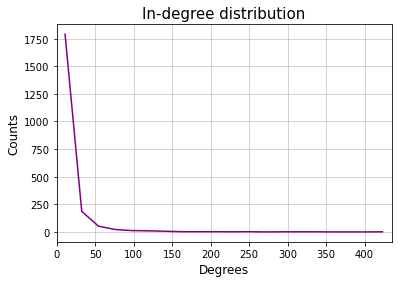

In [5]:
plt.title('In-degree distribution', size=15)
plt.xlabel('Degrees', size=12)
plt.ylabel('Counts', size=12)
plt.plot(binmids, height, color='purple')
plt.grid(alpha=0.7)
plt.rc('axes', axisbelow=True)
plt.xscale("linear")
plt.yscale("linear")
plt.xlim(0, max_+1);

In [6]:
out_degs = [i[1] for i in G.out_degree()]

min_ = min(out_degs)
max_ = max(out_degs)
        
height, bins = np.histogram(out_degs, bins=np.arange(min_,max_+2) - 1/2)

binmids = []
for i in range(len(bins)-1):
    binmids.append((bins[i]+bins[i+1])/2)

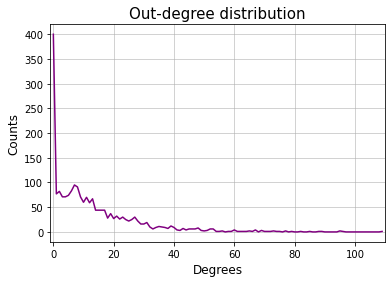

In [7]:
plt.title('Out-degree distribution', size=15)
plt.xlabel('Degrees', size=12)
plt.ylabel('Counts', size=12)
plt.plot(binmids, height, color='purple')
plt.grid(alpha=0.7)
plt.rc('axes', axisbelow=True)
plt.xscale("linear")
plt.yscale("linear")
plt.xlim(-1, max_+1);

* Estimate the slope of the incoming degree distribtion as described in Lecture 5.

We use the ``powerlaw`` library to estimate the slope.

In [8]:
print(powerlaw.Fit([G.in_degree(node) for node in G.nodes()]).alpha)

Calculating best minimal value for power law fit
2.5329034312435397


Values less than or equal to 0 in data. Throwing out 0 or negative values


The authors of the paper found that the slope of the out-degrees are slightly higher than the slope of the in-degrees. And according to them, the out-degree distribution is often not a clear power law. This is also what we see in the degree distribution plots above.

* Plot the network using the Force Atlas algorithm as described in Lecture 5.

We will now plot the network using the Force Atlas algorithm. First, we find the greatest connected component. 

In [4]:
# make G undirected
G_undirected = G.to_undirected()

# get node attribute "universe" of the undirected graph
node_attr = nx.get_node_attributes(G_undirected, "universe")

largest_cc = G.subgraph(max(nx.connected_components(G_undirected), key=len)).copy()
print("Number of nodes in the largest connected component:", len(largest_cc.nodes()))

Number of nodes in the largest connected component: 2087


Thereafter, we compute the parameters necessary for plotting the network with the Force Atlas algorithm. The node size of each node depends on the degree of the node. The colour of each node depends on whether it belongs to the Marvel or DC universe. Finally, there are three different edge colours: one for links between two Marvel characters, one for links between two DC characters and one for linking two nodes from different universes.

In [10]:
# compute node size 
node_size = [G_undirected.degree()[i] for i in G_undirected.nodes()]

# create colormap of each node
color_map = ["#C41E3A" if node_attr[n] == 'marvel' else "#000000" for n in G_undirected.nodes()]

# create colormap for edges
color_a = '#00FFFF' # cyan
color_b = '#FFC300' # yellow
color_c = '#BF40BF' # magenta

edge_color = []

for edge in G_undirected.edges():
    from_, to_ = edge
    if node_attr[from_] == 'marvel' and node_attr[to_] == 'marvel':
        edge_color.append(color_a)
    elif node_attr[from_] == 'dc' and node_attr[to_] == 'dc':
        edge_color.append(color_b)
    else:
        edge_color.append(color_c)
        

100%|██████████████████████████████████████████████████████████████████████████████| 2000/2000 [05:28<00:00,  6.10it/s]


BarnesHut Approximation  took  35.12  seconds
Repulsion forces  took  280.76  seconds
Gravitational forces  took  0.83  seconds
Attraction forces  took  1.90  seconds
AdjustSpeedAndApplyForces step  took  3.59  seconds


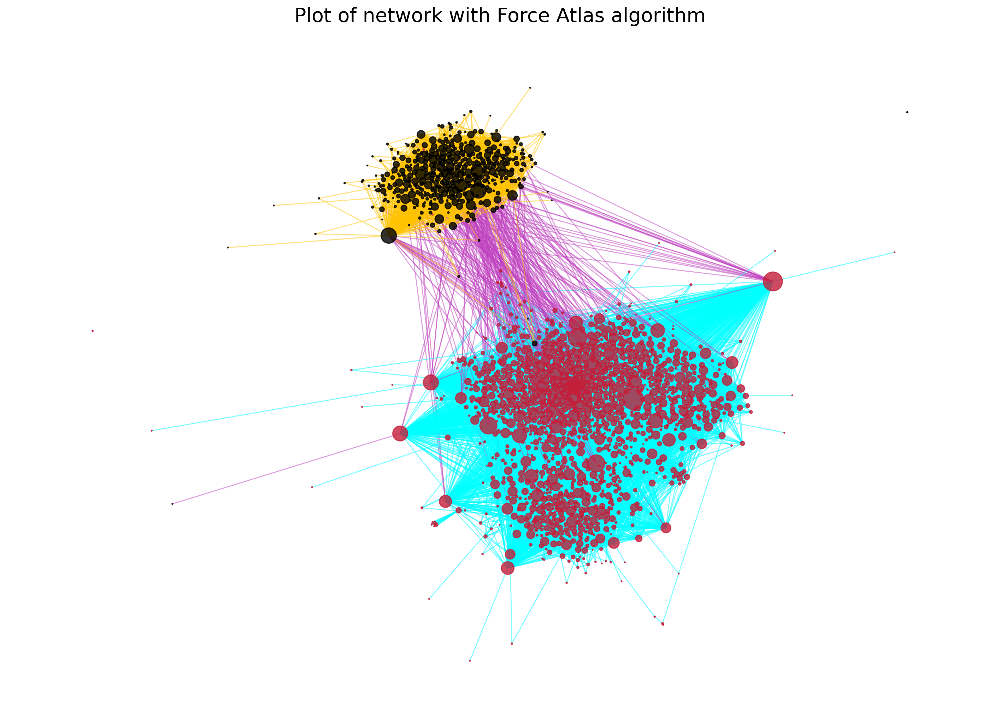

In [11]:
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.1,
                        strongGravityMode=False,
                        gravity=10.0,

                        # Log
                        verbose=True)

fig = plt.figure(figsize=(18,13), dpi=200)
plt.title("Plot of network with Force Atlas algorithm", fontsize=20)
positions = forceatlas2.forceatlas2_networkx_layout(G_undirected, pos=None, iterations=2000)
nx.draw_networkx_nodes(G_undirected, positions, node_size=node_size, node_color=color_map, alpha=0.8)
nx.draw_networkx_edges(G_undirected, positions, edge_color=edge_color, alpha=0.5)
plt.axis('off')
plt.show()

# Communities

Find and visualize the communities in one or both of the superhero universes (DC/Marvel) as described in Week 7.

Write a paragraph about your work to identify the communities. The paragraph should include

* Information about the algorithm you used to find communities.
* The value of modularity for your network.
* The number of communities and their sizes (in terms of number of nodes).

If we have a graph and partition in into a set of communities, we would like to somehow measure how good this partition is. This is exactly what _modularity_ does - given a partition, it calculates a modularity score $M_c$ for each community $c$ as a measure of how much this community deviates from a random configuration:
$$ M_c=\frac{L_c}{L}-\left(\frac{k_c}{2 L}\right)^2 $$
Here, $L_c$ is the number of links in community $c$, $L$ is the number of links in the whole network, and $k_c$ is the total degree in $c$. A positive $M_c$ means that the community subgraph has more links than expected, meaning that it has a community like structure.

The modularity score for the whole partition can then simply be calculated as

$$M=\sum_c{M_c}$$

(from book, chapter 9.4).

In [5]:
def computeModularity(G, partition):
    #Here the partition input is an attribute that we will partition the data set by
    partitions = np.unique(list(nx.get_node_attributes(G,partition).values()))
    partition_dic = {part: [] for part in partitions}
    
    N = len(G.nodes())
    L = len(G.edges())
    
    modularity = 0
    for key in partition_dic.keys():
        for node in G.nodes():
            part = G.nodes[node][partition]
            partition_dic[part].append(node)
        community = nx.Graph.subgraph(G, partition_dic[key])
        k_c = sum([G.degree(v) for v in community])
        L_c = len(community.edges())


        modularity += (L_c / L) - (k_c/(2*L))**2
        
    return modularity
computeModularity(G_undirected,'universe')

0.2855944173634546

The universes are a decent partitioning, as the modularity is 0.286. However ...

In [20]:
# import community as community
# #find marvel nodes
# marvel_nodes = (
#     node
#     for node, data
#     in G_undirected.nodes(data=True)
#     if data.get("universe") == "marvel"
# )
# # nx.get_node_attributes(G,'universe')
# m_G = G_undirected.subgraph(marvel_nodes)
# partition = community.best_partition(m_G)


In [21]:
# import community.community_louvain as community_louvain
# import matplotlib.cm as cm
# import matplotlib.pyplot as plt
# import networkx as nx
# G = nx.karate_club_graph()
# # compute the best partition
# partition = community_louvain.best_partition(G)
# partition

In [22]:
# def computeModularity(G, partition):
#     #Here we use the partition calculated by community as the partition input instead. The function has been modified accordingly
#     partitions = np.unique(list(partition.values()))
#     partition_dic = {part: [] for part in partitions}
#     N = len(G.nodes())
#     L = len(G.edges())
    
#     modularity = 0
#     for key in partition_dic:#_dic.keys():
#         for node in G.nodes():
#             part = partition[node]
#             partition_dic[part].append(node)
#         community = nx.Graph.subgraph(G, partition_dic[key])
#         k_c = sum([G.degree(v) for v in community])
#         L_c = len(community.edges())


#         modularity += (L_c / L) - (k_c/(2*L))**2
        
#     return modularity
# modularity = computeModularity(m_G,partition)
# modularity

In [28]:
filepath = os.getcwd()
with open(filepath+'\\partition.pickle', 'rb') as handle:
    part = pickle.load(handle)

In [64]:
for node in m_G.nodes():
    m_G.nodes()[node]['louvain'] = part[node]

In [137]:
# parameters for nx.draw
import random

degrees = [d[1] for d in nx.degree(m_G)]

color_map = []

hex_cols = []

# from https://stackoverflow.com/questions/13998901/generating-a-random-hex-color-in-python
r = lambda: random.randint(0,255)
for i in range(len(np.unique(list(part.values())))):
    hex_col = '#%02X%02X%02X' % (r(),r(),r())
    hex_cols.append(hex_col)

for com in part.values():
    color_map.append(hex_cols[com])

In [138]:
# list containing node lists for each each Louvain attribute
nodeAtsList = []
for i in range(len(np.unique(list(part.values())))):
    nodesByAts = [x for x,y in m_G.nodes(data=True) if y['louvain']==i]
    nodeAtsList.append(nodesByAts)

100%|████████████████████████████████████████████████████████████████████████████████| 500/500 [00:25<00:00, 19.85it/s]


BarnesHut Approximation  took  3.26  seconds
Repulsion forces  took  20.93  seconds
Gravitational forces  took  0.10  seconds
Attraction forces  took  0.16  seconds
AdjustSpeedAndApplyForces step  took  0.36  seconds


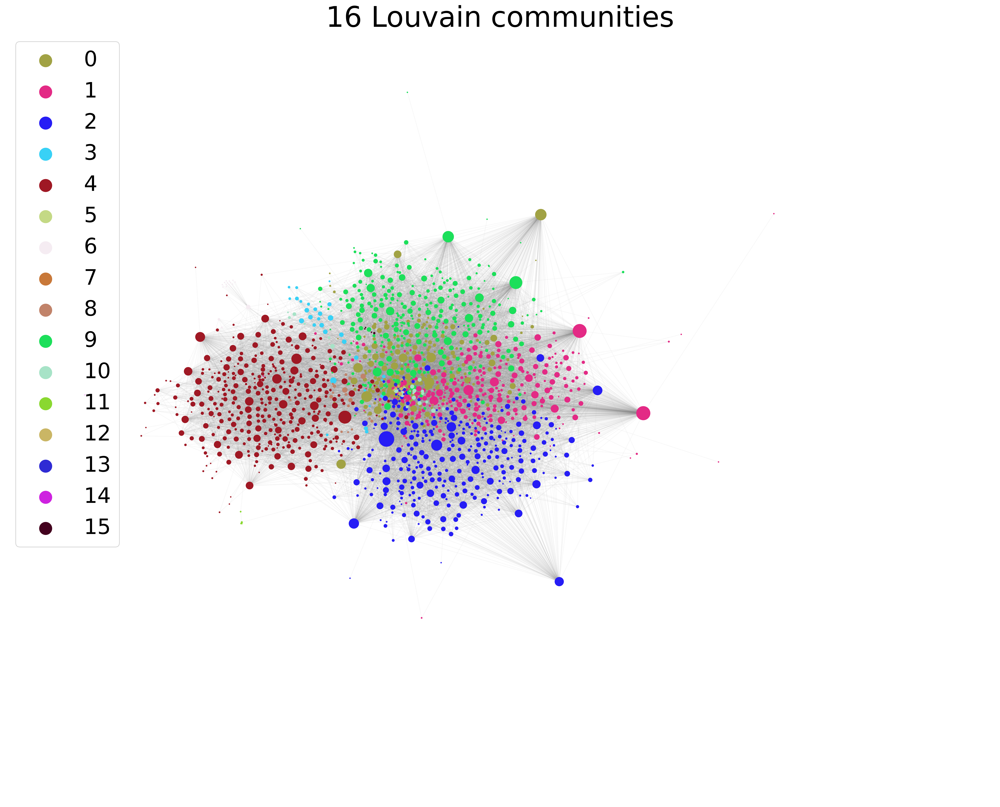

In [140]:
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.1,
                        strongGravityMode=False,
                        gravity=30.0,

                        # Log
                        verbose=True)


fig = plt.figure(figsize=(25,20), dpi=400)
positions = forceatlas2.forceatlas2_networkx_layout(m_G, pos=None, iterations=500)

# create the legend for each Louvain attribute
for i in range(len(np.unique(list(part.values())))):
    nx.draw_networkx_nodes(m_G, positions, node_size=[m_G.degree()[node] for node in nodeAtsList[i]]
                           , nodelist = nodeAtsList[i], node_color=hex_cols[i], label = str(i))

nx.draw_networkx_edges(m_G, positions, edge_color="grey", alpha=0.05)
plt.title("{} Louvain communities".format(len(np.unique(list(part.values())))), fontsize=40)
lgnd = plt.legend(prop = {'size':30}, loc="upper left")

for handle in lgnd.legendHandles:
    handle.set_sizes([300.0])

plt.axis('off')
plt.show()

In [146]:
for i in range(len(np.unique(list(part.values())))):
    print('Louvain community {0}, size: {1}'.format(i, len(nodeAtsList[i])))

Louvain community 0, size: 218
Louvain community 1, size: 311
Louvain community 2, size: 302
Louvain community 3, size: 31
Louvain community 4, size: 350
Louvain community 5, size: 1
Louvain community 6, size: 20
Louvain community 7, size: 1
Louvain community 8, size: 23
Louvain community 9, size: 298
Louvain community 10, size: 28
Louvain community 11, size: 4
Louvain community 12, size: 11
Louvain community 13, size: 11
Louvain community 14, size: 2
Louvain community 15, size: 4


In [83]:
print("Number of partitionings:", len(np.unique(list(partition.values()))))


#Count number of nodes in each partitioning:
partitions = np.unique(list(partition.values()))
partition_dic = {part: [] for part in partitions}
for part in partition_dic.keys():
    count = 0
    for key in partition:
        if partition[key] == part:
            count += 1
    partition_dic[part]=count
print("Partitioning sizes:",partition_dic)

Number of partitionings: 14
Partitioning sizes: {0: 1, 1: 311, 2: 343, 3: 40, 4: 3, 5: 379, 6: 68, 7: 35, 8: 25, 9: 1, 10: 4, 11: 399, 12: 2, 13: 4}


In [118]:
#plot communities
len([])

0

We use the python louvain algorithm to find communities in the graph. WE choose to look at communities in the Marvel network.


> For the 10 largest communities, process the text in order to create a TF-IDF vector for each community. Explain in your own words how TF-IDF works.

In [85]:
import pandas as pd
#load dataframe:
df = pd.read_pickle("df.pickle")


In [126]:
from nltk.corpus import stopwords

community_dic = {part: [] for part in partition_dic.keys()}
for part in partition_dic.keys():#for each community 
    community_doc = str()
    for node in [key for (key,value) in partition.items() if value==part]:#for each character in that community
        tokens = list(df.loc[df["WikiLink"]==node]['WikiText'])
        
        
        if len(tokens)!=0:#split the clean text into tokens
            community_doc +=' '+ tokens[0]#add extra space to ensure we can split into tokens later
        else:
            break
    #tokenize:
    community_dic[part]=community_doc

{0: ' Miracleman (Michael ("Micky" / "Mike" Moran), originally known as Marvelman, is a fictional superhero appearing in comic books first published by L. Miller & Son, Ltd. Created in 1954 by writer-artist Mick Anglo for publisher L. Miller & Son as a United Kingdom home-grown substitute for the American character Captain Marvel, the original series ran until 1963. It was revived in 1982 in a dark, post-modern reboot by writer Alan Moore, with later contributions by Neil Gaiman.\n\nPublication history\nThe Mick Anglo years\nIn 1953, the American company Fawcett Comics, which was the US publisher of Captain Marvel, discontinued the title because of a lawsuit from DC Comics. (Originally printed in Comics Buyer\'s Guide) Len Miller and his company L. Miller & Son, Ltd. had been publishing black-and-white reprints of the series, along with other Fawcett titles, in the UK. Rather than stopping, he turned to comic packager Mick Anglo for help continuing or replacing the comic. They transfor

In [139]:
#calculate TF
from tqdm import tqdm
TF_big_dic =  {} #( ͡° ͜ʖ ͡°)
N = 10
for part in tqdm(community_dic.keys()):
    TF_dic = {}
    text = community_dic[part]
    text = text.replace("\n"," ")
    text = text.replace("\\","")
    text = text.replace(".","").replace(",","").replace("!","").replace("?","")
    text = community_dic[part].split(" ")
    for word in np.unique(text):
        TF_dic[word]=text.count(word)
    TF_big_dic[part]=TF_dic

100%|█████████████████████████████████████████████████████████████████████████████████| 14/14 [32:11<00:00, 137.97s/it]


In [141]:
with open('TF_dict.pickle', 'wb') as handle:
    pickle.dump(TF_big_dic, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [136]:
IDF_big_dic = {}
for part in tqdm(community_dic.keys()):
    IDF_dic = {}
    for word in TF_big_dic[part].keys():
        
        count = 0
        for part2 in community_dic.keys():
            if word in community_dic[part2].keys():
                count += 1
        IDF_dic[word]=np.log(N/count)
TF_IDF_big_dic = {}
for part in tqdm(community_dic.keys()):
    TF_IDF_dic = {}
    for word in community_dic[part].keys():
        TF_IDF_dic[word]=TF_dic[word]*IDF_dic[word]
        
massive_dic = {TF:TF_big_dic,IDF:IDF_big_dic,TF_IDF:TF_IDF_big_dic}

  0%|                                                                                           | 0/14 [00:00<?, ?it/s]


AttributeError: 'str' object has no attribute 'keys'

In [ ]:
with open('TF_IDF_dict.pickle', 'wb') as handle:
    pickle.dump(massive_dic, handle, protocol=pickle.HIGHEST_PROTOCOL)

> Then visualize the TF-IDF vectors using wordclouds (as described in Week 7). Remember to comment on your word-clouds (e.g. in the figure captions): Do the wordclouds/TF-IDF lists enable you to understand the communities you have found (or is it just gibberish)? Justify your answer.

# Sentiment

First calculate the sentiment for all character pages. Calculate the mean value of the sentiment and the 10th and 90th percentile values for the sentiment. Then create a nice histogram displaying the distribution of sentiment values for all pages. Indicate the mean, etc on that histogram.

Now grab the good/bad character names ([from this file](https://raw.githubusercontent.com/SocialComplexityLab/socialgraphs2022/b1668fe5fbea0765ed6f9cf896bfaf208a13765b/files/wiki_meta_data.csv), see Week 8 for details) and calculate the same stats for only good/bad characters; also plot the histograms for the good/bad group and indicate the values of the mean, etc.

Finally use the label permutation test (see Week 5) to investigate the two hypotheses below
* H1: Good characters have a higher average value for sentiment than a similarly sized set of randomly selected characters.
* H2: Bad characters have a lower average value for sentiment than a similarly sized set of randomly selected characters.

Write a short paragraph reflecting on your findings.